In [1]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.datasets import cifar100
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping

# GPU'nun tanınıp tanınmadığını kontrol et
print("GPU Available:", tf.config.list_physical_devices('GPU'))

# Veri setini yükleme
(x_train, y_train), (x_test, y_test) = cifar100.load_data()1

# Veri ön işleme
x_train = x_train / 255.0
x_test = x_test / 255.0
y_train = to_categorical(y_train, 100)  # One-hot encode
y_test = to_categorical(y_test, 100)

# Veri artırma (augmentation)
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    zoom_range=0.2  # Görüntü yakınlaştırma
)
datagen.fit(x_train)

# Model tanımlama
model = Sequential([
    # İlk konvolüsyon bloğu
    Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=(32, 32, 3)),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),  # (32, 32, 3) -> (16, 16, 64)
    Dropout(0.25),
    
    # İkinci konvolüsyon bloğu
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),  # (16, 16, 128) -> (8, 8, 128)
    Dropout(0.35),
    
    # Üçüncü konvolüsyon bloğu
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),  # (8, 8, 256) -> (4, 4, 256)
    Dropout(0.4),

    # Dördüncü konvolüsyon bloğu
    Conv2D(512, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(512, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)), # (4, 4, 512) -> (2, 2, 256)
    Dropout(0.5),
    
    # Tam bağlantılı katmanlar
    Flatten(),
    Dense(1024, activation='relu'),
    BatchNormalization(),
    Dropout(0.5),
    Dense(512, activation='relu'),
    BatchNormalization(),
    Dropout(0.5),
    Dense(100, activation='softmax')
])

# EarlyStopping Callback
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True
)

# Learning Rate Scheduler Callback
lr_scheduler = ReduceLROnPlateau(monitor='val_loss',  
                                 factor=0.3,         
                                 patience=5,         
                                 min_lr=1e-6,        
                                 verbose=1)          

# Modeli derleme
model.compile(optimizer=Adam(learning_rate=0.001), 
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Modeli Eğit
history = model.fit(datagen.flow(x_train, y_train, batch_size=32),
                    validation_data=(x_test, y_test),
                    epochs=100,
                    callbacks=[lr_scheduler, early_stopping])

# Test doğruluğu
test_loss, test_acc = model.evaluate(x_test, y_test, verbose=2)
print(f"Test accuracy: {test_acc:.3%}")


GPU Available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Epoch 1/100
1563/1563 [==============================] - 31s 14ms/step - loss: 4.5723 - accuracy: 0.0532 - val_loss: 4.1088 - val_accuracy: 0.0849
Epoch 2/100
1563/1563 [==============================] - 20s 13ms/step - loss: 3.9222 - accuracy: 0.1016 - val_loss: 3.5305 - val_accuracy: 0.1624
Epoch 3/100
1563/1563 [==============================] - 20s 13ms/step - loss: 3.5864 - accuracy: 0.1425 - val_loss: 3.1817 - val_accuracy: 0.2117
Epoch 4/100
1563/1563 [==============================] - 21s 13ms/step - loss: 3.3092 - accuracy: 0.1873 - val_loss: 3.2546 - val_accuracy: 0.2264
Epoch 5/100
1563/1563 [==============================] - 21s 13ms/step - loss: 3.0673 - accuracy: 0.2295 - val_loss: 2.6693 - val_accuracy: 0.3085
Epoch 6/100
1563/1563 [==============================] - 21s 14ms/step - loss: 2.8686 - accuracy: 0.2715 - val_loss: 2.4696 - val_accuracy: 0.3475
Epoch 7/100
1563/1563 [=============

In [2]:
import matplotlib.pyplot as plt
import numpy as np

# Eğitim doğruluk grafiğini çizme
def plot_accuracy(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    epochs = range(1, len(acc) + 1)

    plt.figure(figsize=(10, 6))
    plt.plot(epochs, acc, label='Training Accuracy', marker='o')
    plt.plot(epochs, val_acc, label='Validation Accuracy', marker='o')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)
    plt.show()

# Eğitim kaybı grafiğini çizme
def plot_loss(history):
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(loss) + 1)

    plt.figure(figsize=(10, 6))
    plt.plot(epochs, loss, label='Training Loss', marker='o')
    plt.plot(epochs, val_loss, label='Validation Loss', marker='o')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    plt.show()

# Tahmin fonksiyonu
def make_predictions(model, x_data):
    predictions = model.predict(x_data)
    return np.argmax(predictions, axis=1)

def show_predictions(x_data, y_data, model, class_names, count=1000, cols=7):
    """
    Modelin tahmin sonuçlarını gösterir, yan yana belirli sayıda görsel sıralar.
    
    Parameters:
        x_data (ndarray): Görsel veri seti.
        y_data (ndarray): Etiket veri seti (one-hot encoded).
        model (Model): Keras modeli.
        class_names (list): Sınıf isimleri listesi.
        count (int, optional): Gösterilecek tahmin sayısı (varsayılan: Tüm veri).
        cols (int): Her satıra yerleşecek görsel sayısı (varsayılan: 7).
    """
    predictions = make_predictions(model, x_data)
    y_true = np.argmax(y_data, axis=1)
    
    rows = (count + cols - 1) // cols  # Satır sayısını belirle
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = axes.flatten()  # Tüm eksenleri tek boyutlu hale getir
    
    for i in range(count):
        axes[i].imshow((x_data[i] * 255).astype('uint8'))
        axes[i].axis('off')
        axes[i].set_title(f"Tahmin: {class_names[predictions[i]]}\nDoğru: {class_names[y_true[i]]}", fontsize=12)
    
    # Kullanılmayan boş eksenleri kaldır
    for i in range(count, len(axes)):
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()



# Yanlış tahminleri gösteren fonksiyon
def show_wrong_predictions(x_data, y_data, model, class_names, class_name=None, count=1000, cols=7):
    predictions = make_predictions(model, x_data)
    y_true = np.argmax(y_data, axis=1)
    wrong_indices = np.where(predictions != y_true)[0]

    rows = (count + cols - 1) // cols  # Satır sayısını belirle
    
    print(f"Yanlış tahmin sayısı: {len(wrong_indices)}")
    if len(wrong_indices) == 0:
        print("HATASIZ KUL OLMAZ AMA MODEL OLUR")
        return
    
    if class_name:
        class_index = class_names.index(class_name)
        class_indices = np.where(y_true == class_index)[0]
        if len(class_indices) == 0:
            print(f"X '{class_name}'")
            return
        wrong_indices = class_indices

    # Hangi sınıfta en fazla hata yapıldığını bul
    incorrect_counts = np.zeros(len(class_names), dtype=int)
    for i in wrong_indices:
        incorrect_counts[y_true[i]] += 1
    most_common_error_class = np.argmax(incorrect_counts)
    
    print(f"En çok {class_names[most_common_error_class]} sınıfında {incorrect_counts[most_common_error_class]} adet hata yapıldı.")
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = axes.flatten()  # Tüm eksenleri tek boyutlu hale getir
    
    for i, ax in zip(wrong_indices[:count], axes):
        ax.imshow((x_data[i] * 255).astype('uint8'))
        ax.axis('off')
        ax.set_title(f"Tahmin:{class_names[predictions[i]]}\nGerçek:{class_names[y_true[i]]}", fontsize=12)
    
    plt.tight_layout()
    plt.show()

# Doğru tahminleri gösteren fonksiyon
def show_true_predictions(x_data, y_data, model, class_names, class_name=None, count=1000, cols=7):
    predictions = make_predictions(model, x_data)
    y_true = np.argmax(y_data, axis=1)
    true_indices = np.where(predictions == y_true)[0]

    rows = (count + cols - 1) // cols  # Satır sayısını belirle
    
    print(f"Doğru tahmin sayısı: {len(true_indices)}")
    if len(true_indices) == 0:
        print("HEPSİ YANLIŞ :(")
        return
    
    if class_name:
        class_index = class_names.index(class_name)
        class_indices = np.where(y_true == class_index)[0]
        if len(class_indices) == 0:
            print(f"No correct predictions for class '{class_name}'")
            return
        true_indices = class_indices

    # Hangi sınıfta en fazla doğru tahmin yapıldığını bul
    correct_counts = np.zeros(len(class_names), dtype=int)
    for i in true_indices:
        correct_counts[y_true[i]] += 1
    most_common_true_class = np.argmax(correct_counts)
    
    print(f"En çok {class_names[most_common_true_class]} sınıfı, {correct_counts[most_common_true_class]} adet doğru tahmin edildi.")
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = axes.flatten()  # Tüm eksenleri tek boyutlu hale getir
    
    for i, ax in zip(true_indices[:count], axes):
        ax.imshow((x_data[i] * 255).astype('uint8'))
        ax.axis('off')
        ax.set_title(f"Tahmin:{class_names[predictions[i]]}\nGerçek:{class_names[y_true[i]]}", fontsize=12)
    
    plt.tight_layout()
    plt.show()

# CIFAR-100 sınıf isimlerini yükleme
from tensorflow.keras.datasets import cifar100
class_names = [
    'Elma', 'Akvaryum Balığı', 'Bebek', 'Ayı', 'Kunduz', 'Yatak', 'Arı', 'Böcek', 'Bisiklet', 'Şişe', 
    'Kase', 'Erkek Çocuk', 'Köprü', 'Otobüs', 'Kelebek', 'Deve', 'Kutu', 'Kale', 'Tırtıl', 'Sığır',
    'Sandalye', 'Şempanze', 'Saat', 'Bulut', 'Hamam böceği', 'Kanepe', 'Yengeç', 'Timsah', 'Fincan', 'Dinozor',
    'Yunus', 'Fil', 'Yassı balık', 'Orman', 'Tilki', 'Kız', 'Hamster', 'Ev', 'Kanguru', 'Klavye',
    'Lamba', 'Çim biçme makinesi', 'Leopar', 'Aslan', 'Kertenkele', 'Istakoz', 'Adam', 'Akçaağaç', 'Motosiklet', 'Dağ',
    'Fare', 'Mantar', 'Meşe ağacı', 'Portakal', 'Orkide', 'Su samuru', 'Palmiye ağacı', 'Armut', 'Kamyonet', 'Çam ağacı',
    'Ova', 'Tabak', 'Gelincik', 'Kirpi', 'Opossum', 'Tavşan', 'Rakun', 'Vatoz', 'Yol', 'Roket', 'Gül', 'Deniz',
    'Fok balığı', 'Köpek balığı', 'Fare benzeri kemirgen', 'Kokarca', 'Gökdelen', 'Salyangoz', 'Yılan', 'Örümcek', 'Sincap', 'Tramvay', 'Ayçiçeği',
    'Biber', 'Masa', 'Tank', 'Telefon', 'Televizyon', 'Kaplan', 'Traktör', 'Tren', 'Alabalık', 'Lale', 'Kaplumbağa',
    'Gardırop', 'Balina', 'Söğüt ağacı', 'KURT', 'Kadın', 'Solucan'
]


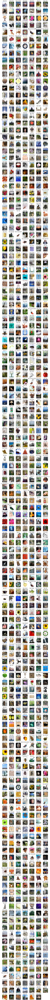

In [3]:
# Tahminlerin ve görsellerin listelenmesi
show_predictions(x_test, y_test, model, class_names)

Yanlış tahmin sayısı: 3299
En çok Su samuru sınıfında 78 adet hata yapıldı.


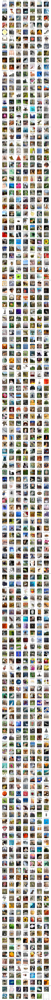

In [8]:
# Yanlış tahminlerin gösterimi
show_wrong_predictions(x_test, y_test, model, class_names)

Doğru tahmin sayısı: 6701
En çok Motosiklet sınıfı, 97 adet doğru tahmin edildi.


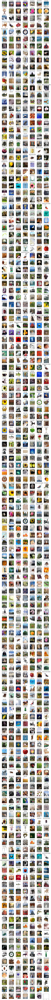

In [5]:
# Doğru tahminlerin gösterimi
show_true_predictions(x_test, y_test, model, class_names)

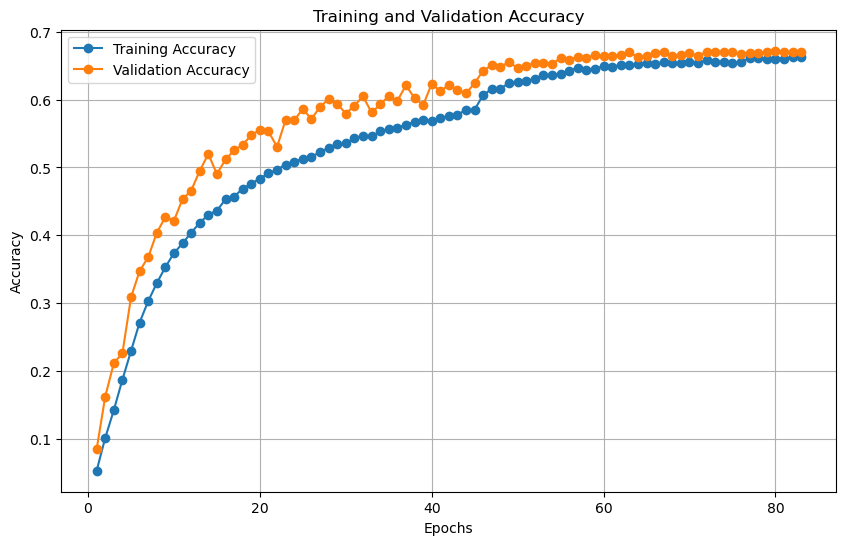

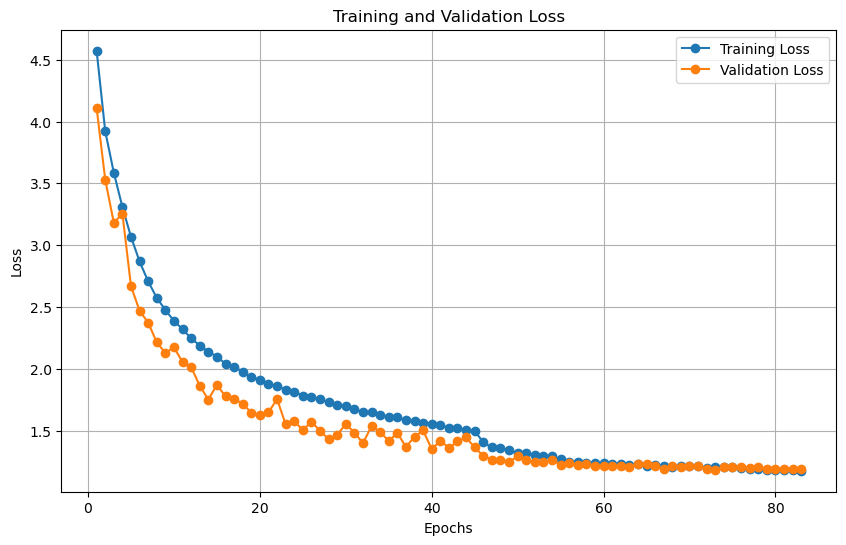

In [6]:
plot_accuracy(history)
plot_loss(history)

In [1]:
show_wrong_predictions(x_test, y_test, model, class_names, "Ayı")

NameError: name 'show_wrong_predictions' is not defined